In [1]:
import os
import easydict
import json

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import numpy as np
import pickle
import scipy
from matplotlib import pyplot as plt

from torch.utils.data import DataLoader, TensorDataset
from models import load_backbone, Classifier

from data import get_base_dataset
from utils import Logger, set_seed, set_model_path, save_model, load_augment, add_mislabel_dataset
from training.common import cut_input, get_embed, data_aug

In [2]:
from scores_src import get_features, merge_multiple_models
from scores_src import avg_conf_variab, avg_forgetting, avg_aum
from scores_src import get_density_score, get_mlm_scores, masking_dataset, get_mlm_scores_jh, get_sentence_embedding
from scores_src import confidence, entropy, badge_grads_norm
from scores_src.ensembles import mc_dropout_models, el2n_score, ens_max_ent, ens_bald, ens_varR

from scores_src.info import get_infoverse, aggregate

# Preliminary

In [3]:
args = easydict.EasyDict({"batch_size": 64, 
                          "backbone": 'roberta_large',
                          "dataset": 'cola',
                          "train_type": '0101_base_large',
                          "seed": 1234,
                          "name": '0611_base_noisy',
                          "pre_ckpt": './logs/qnli_R1.0_roberta_large_0611_base_noisy_GA1_N1.0_S1234/qnli_roberta-large_0611_base_noisy_epoch7.model',
                          "score_type": 'confidence',
                          "topK": True,
                          "data_ratio": 1.0,
                          "n_classes": 2,
                        })

Adding syntactic noise label to train dataset

In [4]:
backbone, tokenizer = load_backbone(args.backbone)

2022-07-27 04:26:41.082934: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /home/jaehyung/torch/install/lib:/home/jaehyung/torch/install/lib:/usr/local/cuda/lib64:/home/jaehyung/torch/install/lib:/home/jaehyung/torch/install/lib:/usr/local/cuda/lib64:
2022-07-27 04:26:41.082971: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
In Transformers v4.0.0, the default path to cache downloaded models changed from '~/.cache/torch/transformers' to '~/.cache/huggingface/transformers'. Since you don't seem to have overridden and '~/.cache/torch/transformers' is a directory that exists, we're moving it to '~/.cache/huggingface/transformers' to avoid redownloading models you have already in the cache. You should only see this message once.
Some weig

In [5]:
dataset, train_loader, val_loader, test_loader = get_base_dataset(args.dataset, tokenizer, args.batch_size, args.data_ratio, args.seed, shuffle=False)

Initializing base dataset... (name: cola)


In [6]:
train_loader = DataLoader(dataset.train_dataset, shuffle=False, drop_last=False, batch_size=args.batch_size, num_workers=4)

In [7]:
labels_v = dataset.val_dataset[:][1][:, 0].numpy()

In [8]:
labels_t = dataset.train_dataset[:][1][:, 0].numpy()

In [9]:
model = Classifier(args.backbone, backbone, dataset.n_classes, args.train_type).cuda()
if args.pre_ckpt is not None:
    model.load_state_dict(torch.load(args.pre_ckpt))

## Constructing InfoVerse

In [10]:
# Generation of Infoverse in training set: pool_dataset=dataset.train_dataset
# Generation of Infoverse in val set: pool_dataset=dataset.val_dataset & active=True
infoverse = get_infoverse(args, 
                          label_dataset=dataset.train_dataset, 
                          pool_dataset=dataset.val_dataset, 
                          n_epochs=2, 
                          seeds_list=[1234], 
                          n_class=2, 
                          active=False)

Some weights of RobertaForMaskedLM were not initialized from the model checkpoint at roberta-large and are newly initialized: ['lm_head.decoder.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/home/jaehyung/workspace/InfoVerse_code/scores_src/others.py:130: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /opt/conda/conda-bld/pytorch_1595629403081/work/torch/csrc/utils/python_arg_parser.cpp:766.)
  mask_idx = mask.nonzero()
Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/home

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [11]:
names = ['avg_conf', 0
 'variab', 1
 'forget_number', 2
 'aum', 3 
 'ens_el2n',4
 'ens_ent',5
 'ens_BALD',6
 'ens_VAR',7
 'ens_avg_conf',8
 'ens_variab',9
 'mc_ens_el2n',10
 'mc_ens_ent',11
 'mc_ens_BALD',12
 'mc_ens_VAR',13
 'mc_ens_avg_conf',14
 'mc_ens_variab',15
 'knn_density',16
 'knn_density_rel',17
 'conf',18
 'ent',19
 'badge',20
 'knn_s_density',21
 'mlm_score', 22]

SyntaxError: invalid syntax (3694472147.py, line 2)

# TSNE

In [17]:
from MulticoreTSNE import MulticoreTSNE as TSNE
from matplotlib import pyplot as plt

## tSEN with OOD Samples

In [13]:
measures_in = infoverse.numpy()

In [15]:
z_all = measures_in
y_all = labels_v

In [16]:
z_all = (z_all - z_all.mean(axis=0)) / z_all.std(axis=0)

/home/jaehyung/anaconda3/envs/pytorch1.6/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: invalid value encountered in true_divide
  """Entry point for launching an IPython kernel.


In [ ]:
embeddings = TSNE(n_jobs=4).fit_transform(z_all)

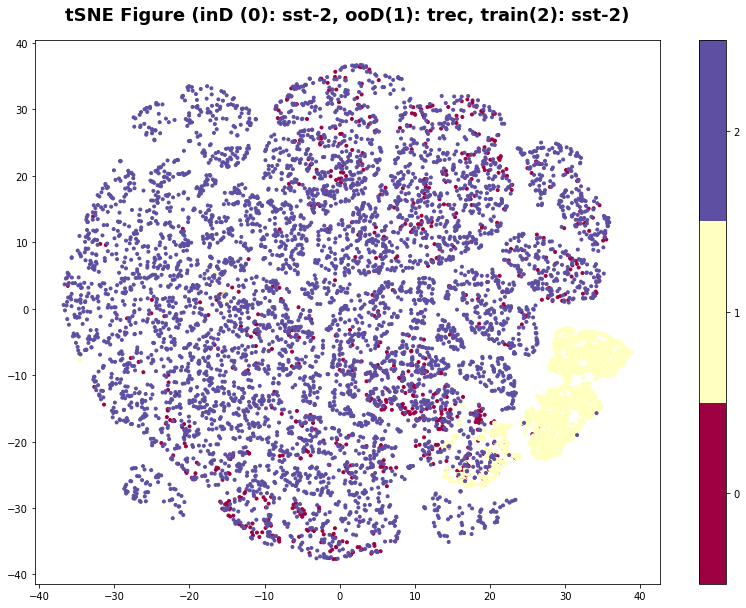

In [82]:
vis_x = embeddings[:10000, 0]
vis_y = embeddings[:10000, 1]

plt.rcParams["figure.figsize"] = (14,10)
plt.scatter(vis_x, vis_y, c=y_all[:10000], cmap=plt.cm.get_cmap("Spectral", 2), marker='.')
plt.colorbar(ticks=range(3))
plt.clim(-0.5, 2.5)
# Title
title_font = {
    'fontsize': 18,
    'fontweight': 'bold'
}
plt.title('tSNE Figure (inD (0): sst-2, ooD(1): trec, train(2): sst-2)', fontdict=title_font, pad=20)

plt.show()

## Constructing HTML file

In [161]:
from bokeh.plotting import figure, show, output_notebook, output_file
from bokeh.models import HoverTool
from bokeh.models import CategoricalColorMapper
from bokeh.models import ColumnDataSource

In [177]:
output_file("sst2_standard_norm.html")

In [178]:
score = (measures_in - measures_in.mean(axis=0)) / measures_in.std(axis=0)

In [165]:
score = (measures_in - measures_in.min(axis=0)) / (measures_in.max(axis=0) - measures_in.min(axis=0))

In [166]:
sentence = []
n_tokens = (features['tokens'] != 1).float().sum(dim=1)

for i in range(len(features['tokens'])):
    n_tokens_i = int(n_tokens[i])
    
    sent_i = tokenizer.decode(features['tokens'][i, 1:n_tokens_i-1])
    sentence.append(sent_i)

In [172]:
raw_label = []

for i in range(len(features['labels'])):
    label = int(features['labels'][i])
    if label == 0:
        raw_label.append('wrong')
    else:
        raw_label.append('correct')

In [179]:
from bokeh.layouts import row, column, gridplot
from bokeh.models import CustomJS, Circle, ColumnDataSource, Slider, LinearColorMapper, ColorBar, TapTool, HoverTool
from bokeh.transform import linear_cmap, transform

# Preliminary
raw_sentence = sentence
raw_label = raw_label
label = list((features['labels'].numpy() - 0.5)/0.5)

x_penul = list(embeddings_penul[:, 0])
y_penul = list(embeddings_penul[:, 1])

x = list(embeddings[:, 0])
y = list(embeddings[:, 1])

c = label
v0 = list(score[:, 0])
v1 = list(score[:, 1])
v2 = list(score[:, 2])
v3 = list(score[:, 3])
v4 = list(score[:, 4])
v5 = list(score[:, 5])
v6 = list(score[:, 6])
v7 = list(score[:, 7])
v8 = list(score[:, 8])
v9 = list(score[:, 9])
v10 = list(score[:, 10])
v11 = list(score[:, 11])
v12 = list(score[:, 12])
v13 = list(score[:, 13])
v14 = list(score[:, 14])
v15 = list(score[:, 15])
v16 = list(score[:, 16])
v17 = list(score[:, 17])
v18 = list(score[:, 18])
v19 = list(score[:, 19])
v20 = list(score[:, 20])
v21 = list(score[:, 21])
v22 = list(score[:, 22])

source = ColumnDataSource(data=dict(sent=raw_sentence, raw_label=raw_label, l=label, x=x, y=y, x_penul=x_penul, y_penul=y_penul, c=c, v0=v0, v1=v1, v2=v2, v3=v3, v4=v4, v5=v5, v6=v6, v7=v7, v8=v8, v9=v9,
                                    v10=v10, v11=v11, v12=v12, v13=v13, v14=v14, v15=v15, v16=v16, v17=v17,
                                    v18=v18, v19=v19, v20=v20, v21=v21, v22=v22,))
hover = HoverTool(
        tooltips=[("index", "$index"), ("(x,y)", "($x, $y)"), ("(sentence, raw_label, label)", "(@sent, @raw_label, @l)"),
            ("Training Dynamics (avg_conf, variab, forget, aum)", "@v0, @v1, @v2, @v3"),
            ("Ensemble (el2n, ent, bald, VAR, conf, variab)", "@v4, @v5, @v6, @v7, @v8, @v9"),
            ("MC Ensemble (el2n, ent, bald, VAR, conf, variab)", "@v10, @v11, @v12, @v13, @v14, @v15"),
            ("Single Model (knn, knn_rel, conf, ent, badge)", "@v16, @v17, @v18, @v19, @v20"),
            ("Linguistic Feature (knn_sent, mlm_roberta)", "@v21, @v22"),      
        ]
    )
tap = TapTool()

TOOLS = [hover, tap, 'box_zoom, pan, reset']
plot = figure(plot_width=800, plot_height=600, tools=TOOLS)

color_mapper = LinearColorMapper(palette="Viridis256", low=-1, high=1)
renderer = plot.circle('x', 'y', source=source, fill_alpha=0.6, color=transform('c', color_mapper))

selected_circle = Circle(fill_alpha=1, fill_color="firebrick", line_color="black")
nonselected_circle = Circle(fill_alpha=0.1, fill_color="blue", line_color="white")

renderer.selection_glyph = selected_circle
renderer.nonselection_glyph = nonselected_circle

color_bar = ColorBar(color_mapper=color_mapper, label_standoff=12, location=(0,0))
plot.add_layout(color_bar, 'right')

slider0 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(0. True Label) ")

slider1 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(1. Training Dynamics) Average Confidence")
slider2 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(1. Training Dynamics) Variability")
slider3 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(1. Training Dynamics) Forgetting Number")
slider4 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(1. Training Dynamics) Area Under Margin")

slider5 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(2. Ensemble) EL2N score")
slider6 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(2. Ensemble) Entropy")
slider7 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(2. Ensemble) BALD")
slider8 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(2. Ensemble) VAR")
slider9 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(2. Ensemble) Average Confidence")
slider10 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(2. Ensemble) Variability")

slider11 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(3. MC Ensemble) EL2N score")
slider12 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(3. MC Ensemble) Entropy")
slider13 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(3. MC Ensemble) BALD")
slider14 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(3. MC Ensemble) VAR")
slider15 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(3. MC Ensemble) Average Confidence")
slider16 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(3. MC Ensemble) Variability")

slider17 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(4. Single Model) KNN density")
slider18 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(4. Single Model) KNN density (rel)")
slider19 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(4. Single Model) Confidence")
slider20 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(4. Single Model) Entropy")
slider21 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(4. Single Model) BADGE")

slider22 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(5. Linguistic fearture) KNN density (sent-bert)")
slider23 = Slider(start=0.0, end=1, value=0.0, step=1.0, title="(5. Linguistic fearture) MLM_score (roberta)")

custom_js_dict = dict(source=source, slider0=slider0,
                      slider1=slider1, slider2=slider2, slider3=slider3, slider4=slider4, slider5=slider5,
                      slider6=slider6, slider7=slider7, slider8=slider8, slider9=slider9, slider10=slider10,
                      slider11=slider11, slider12=slider12, slider13=slider13, slider14=slider14, slider15=slider15,
                      slider16=slider16, slider17=slider17, slider18=slider18, slider19=slider19, slider20=slider20,
                      slider21=slider21, slider22=slider22, slider23=slider23)

update_curve = CustomJS(args=custom_js_dict, code="""
    var data = source.data;
    var f0 = slider0.value;
    var f1 = slider1.value;
    var f2 = slider2.value;
    var f3 = slider3.value;
    var f4 = slider4.value;
    var f5 = slider5.value;
    var f6 = slider6.value;
    var f7 = slider7.value;
    var f8 = slider8.value;
    var f9 = slider9.value;
    var f10 = slider10.value;
    var f11 = slider11.value;
    var f12 = slider12.value;
    var f13 = slider13.value;
    var f14 = slider14.value;
    var f15 = slider15.value;
    var f16 = slider16.value;
    var f17 = slider17.value;
    var f18 = slider18.value;
    var f19 = slider19.value;
    var f20 = slider20.value;
    var f21 = slider21.value;
    var f22 = slider22.value;
    var f23 = slider23.value;
    
    var x = data['x']
    var y = data['y']
    var c = data['c']
    var l = data['l']
    var v0 = data['v0']
    var v1 = data['v1']
    var v2 = data['v2']
    var v3 = data['v3']
    var v4 = data['v4']
    var v5 = data['v5']
    var v6 = data['v6']
    var v7 = data['v7']
    var v8 = data['v8']
    var v9 = data['v9']
    var v10 = data['v10']
    var v11 = data['v11']
    var v12 = data['v12']
    var v13 = data['v13']
    var v14 = data['v14']
    var v15 = data['v15']
    var v16 = data['v16']
    var v17 = data['v17']
    var v18 = data['v18']
    var v19 = data['v19']
    var v20 = data['v20']
    var v21 = data['v21']
    var v22 = data['v22']
    
    for (var i = 0; i < x.length; i++) {
           c[i] = f0 * l[i] + f1 * v0[i] + f2 * v1[i] + f3 * v2[i] + f4 * v3[i] + f5 * v4[i] + f6 * v5[i] + f7 * v6[i] + f8 * v7[i] + f9 * v8[i] + f10 * v9[i] + f11 * v10[i] + f12 * v11[i] + f13 * v12[i] + f14 * v13[i] + f15 * v14[i] + f16 * v15[i] + f17 * v16[i] + f18 * v17[i] + f19 * v18[i] + f20 * v19[i] + f21 * v20[i] + f22 * v21[i] + f23 * v22[i] 
    }
    
    source.change.emit();
""")
slider0.js_on_change('value', update_curve)
slider1.js_on_change('value', update_curve)
slider2.js_on_change('value', update_curve)
slider3.js_on_change('value', update_curve)
slider4.js_on_change('value', update_curve)
slider5.js_on_change('value', update_curve)
slider6.js_on_change('value', update_curve)
slider7.js_on_change('value', update_curve)
slider8.js_on_change('value', update_curve)
slider9.js_on_change('value', update_curve)
slider10.js_on_change('value', update_curve)
slider11.js_on_change('value', update_curve)
slider12.js_on_change('value', update_curve)
slider13.js_on_change('value', update_curve)
slider14.js_on_change('value', update_curve)
slider15.js_on_change('value', update_curve)
slider16.js_on_change('value', update_curve)
slider17.js_on_change('value', update_curve)
slider18.js_on_change('value', update_curve)
slider19.js_on_change('value', update_curve)
slider20.js_on_change('value', update_curve)
slider21.js_on_change('value', update_curve)
slider22.js_on_change('value', update_curve)
slider23.js_on_change('value', update_curve)

# create a new plot and share only one range
plot_penul = figure(plot_width=800, plot_height=600, tools=TOOLS)
renderer2 = plot_penul.circle('x_penul', 'y_penul', source=source, fill_alpha=0.6, color=transform('c', color_mapper))
plot_penul.add_layout(color_bar, 'right')

renderer2.selection_glyph = selected_circle
renderer2.nonselection_glyph = nonselected_circle

show(column(slider0, slider1, slider2, slider3, slider4, slider5, slider6, slider7, slider8, slider9, slider10,
            slider11, slider12, slider13, slider14, slider15, slider16, slider17, slider18, slider19, slider20,
            slider21, slider22, slider23, plot, plot_penul))